<a href="https://colab.research.google.com/github/bijuangalees/Deep_learning_explorations/blob/master/Copy_of_DCGAN_last_shared.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<center><h1>GANart : Introduction To Generative Adversarial Networks





---

*Organized by AI Club and Department Of Computer Science And Engineering, NIT-Calicut* 



# **What are GANs?**

Generative Adversarial Networks (GANs) are one of the most interesting ideas in computer science today. Two models are trained simultaneously by an adversarial process. A generator ("the artist") learns to create images that look real, while a discriminator ("the art critic") learns to tell real images apart from fakes.

A diagram of a generator and discriminator
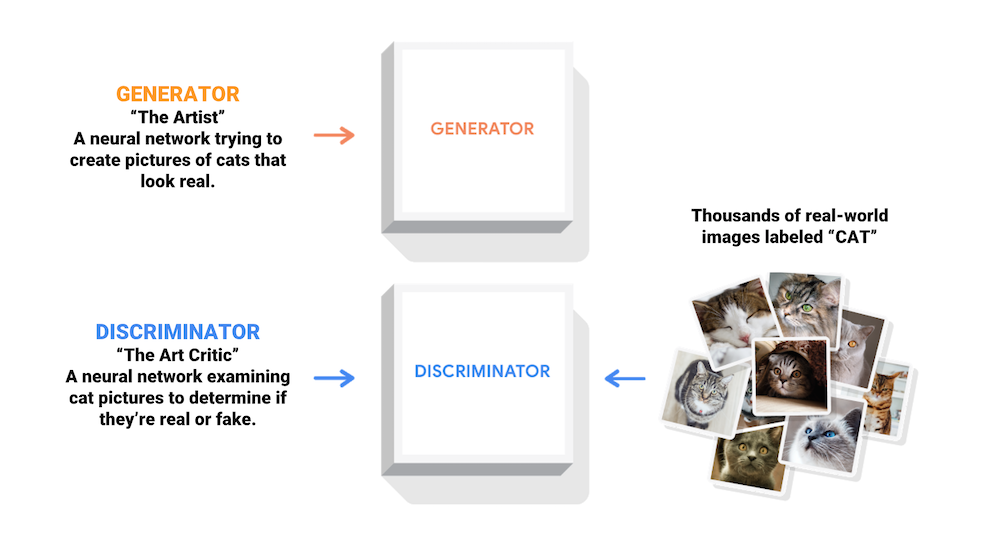

During training, the generator progressively becomes better at creating images that look real, while the discriminator becomes better at telling them apart. The process reaches equilibrium when the discriminator can no longer distinguish real images from fakes.

A second diagram of a generator and discriminator
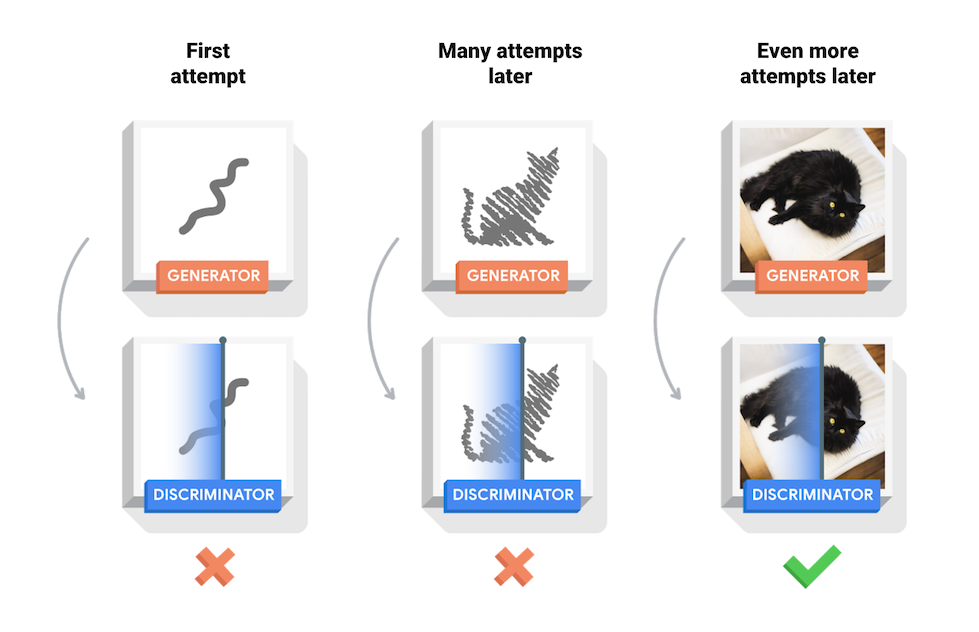

This notebook demonstrates this process on the MNIST Fashion dataset. The following animation shows a series of images produced by the generator as it was trained for 200 epochs. The images begin as random noise, and increasingly resemble fashion images over time.


Source :https://www.tensorflow.org/tutorials/generative/dcgan

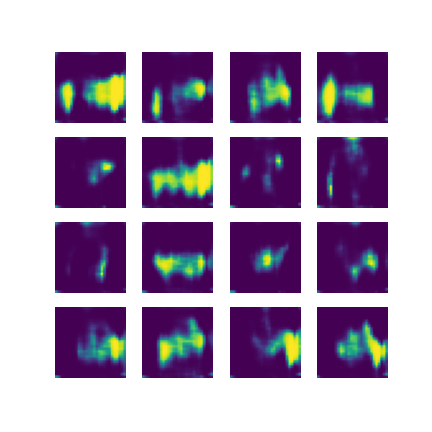

## Steps involved

1. Load and preprocess Dataset.
2. Define the GAN model.
3. Defining loss and optimizers.
4. Training the GAN.
5. Plot and compare results.

## Importing Libraries

In this implementation we make use of helper libraries that assist us in utilising libraries that help us implement a GAN.

## Numpy

Numpy helps in speeding up the mathematical calculations, it also aids the programmer to manipulate metrices and high dimensional data with ease.

[Numpy Documentations](https://numpy.org/)

## Tensorflow

Orginally a library for graph based mathematical processing of high dimensional tensors. It is now widely used for Deep Learning for training and deployment of deep learning model. 

[Tensorflow Documentation](https://www.tensorflow.org/)

### Keras

Now a sub library in the tensorflow framework, which streamlines construction of deep learning models with ease. 

[Keras Documentation](https://www.tensorflow.org/api_docs/python/tf/keras)

In [2]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from keras.layers import *
from keras.models import Model
from matplotlib import pyplot as plt

## TPUs

Tensor Processing Units (TPUs) are Google’s custom-developed application-specific integrated circuits (ASICs) used to accelerate machine learning workloads. TPUs are designed from the ground up with the benefit of Google’s deep experience and leadership in machine learning. [source](https://cloud.google.com/tpu/docs/tpus)

In this implementation we make use of TPUs to accelarate the training of GANs, the snippet below initialized the settings in order to utilise the TPU effectively.

<h3>  &nbsp;&nbsp;Train on TPU&nbsp;&nbsp; <a href="https://cloud.google.com/tpu/"><img valign="middle" src="https://raw.githubusercontent.com/GoogleCloudPlatform/tensorflow-without-a-phd/master/tensorflow-rl-pong/images/tpu-hexagon.png" width="50"></a></h3>

 On the main menu, click Runtime and select **Change runtime type**. Set "TPU" as the hardware accelerator. Then run the below code block.


In [3]:
tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
tf.config.experimental_connect_to_cluster(tpu)
tf.tpu.experimental.initialize_tpu_system(tpu)
# instantiate a distribution strategy
strategy = tf.distribute.experimental.TPUStrategy(tpu)

INFO:tensorflow:Initializing the TPU system: grpc://10.59.49.10:8470


INFO:tensorflow:Initializing the TPU system: grpc://10.59.49.10:8470


INFO:tensorflow:Clearing out eager caches


INFO:tensorflow:Clearing out eager caches


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Found TPU system:


INFO:tensorflow:Found TPU system:


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


### Defining Image Bounds

We aare defining the the image size, as well as the latent vectors dimention. 

In [4]:
IMG_SHAPE= (28,28,1)
# Size of noise vector
noise_dim = 128
BATCH_SIZE = 128

# **Load and prepare the dataset**
You will use the MNIST Fashion dataset to train the generator and the discriminator. The generator will generate fashion images resembling the MNIST Fashion data.

In [8]:
(real_imgs, _ ), _ = tf.keras.datasets.fashion_mnist.load_data()

4423680/4422102 [==============================] - 0s 0us/step


### Pre-processing the Data

Before any deep learning or statistical learning it is essential process and standardise the data. In the next snippet of code we convert the data into `float32` and then scale it so that every pixel in the image lies between -1 and 1. This helps for faster training of the model.

`tf.cast` is used to perform the conversion to the desired data type. More details on on `tf.cast` can be found [here](https://www.tensorflow.org/api_docs/python/tf/cast).

In [10]:
def rescale(x):
    x = tf.cast(x,tf.float32)
    x = (x-127.5)/127.5     # Normalize images between -1 & 1
    return x

## Dataset preparation

Deep Learning involves managing large amount of data, this includes loading of data to memory during the training cycle and shuffling data. Also optimizing the loading can often reduce bottlenecks encountered during training. To facilitate the above mentioned functions, tensorflow provides a [Dataset API](https://www.tensorflow.org/api_docs/python/tf/data/Dataset).


In [11]:
dataset = tf.data.Dataset.from_tensor_slices(real_imgs)
dataset = dataset.shuffle(1000)
dataset = dataset.map(rescale, num_parallel_calls=tf.data.experimental.AUTOTUNE)
dataset = dataset.batch(BATCH_SIZE,drop_remainder=True)

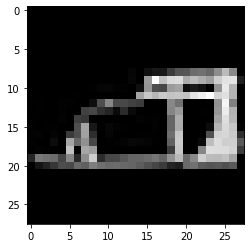

In [ ]:
# View a sample image from the created dataset
for d in dataset:
    im = d[0]
    plt.imshow((im+1)/2, cmap='gray')
    break

# Defining the Model

## Generator

The generator model takes a fixed-length random vector as input and generates a sample in the domain. 

The vector is drawn from randomly from a Gaussian distribution, and the vector is used to seed the generative process. After training, points in this multidimensional vector space will correspond to points in the problem domain, forming a compressed representation of the data distribution.

A good generative model will be able to generate new examples that are indistinguishable with the real data.

The generator uses [`tf.keras.layers.UpSampling2D`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/UpSampling2D)(upsampling) and [`tf.keras.layers.Conv2D`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Conv2D) layers to produce an image from a seed (random noise). 

Start with a Dense layer that takes this seed as input, then upsample several times until you reach the desired image size of **28x28x1**. 

We use [`tf.keras.layers.Activation`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Activation) to define the activation function for each layer. [`tf.keras.layers.ReLU`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/ReLU) is used for each layer except the output layer which uses [`tf.keras.activations.tanh`](https://www.tensorflow.org/api_docs/python/tf/keras/activations/tanh). We also use [`tf.keras.layers.Dense`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Dense) which is used to process the input latent vector. [`tf.keras.layers.Reshape`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Reshape) is used to reshape the tensor to a desired dimension before passing onto convolutional layers.

[**Why use UpSampling2D + Conv2D instead of Conv2DTranspose?**](https://distill.pub/2016/deconv-checkerboard/)

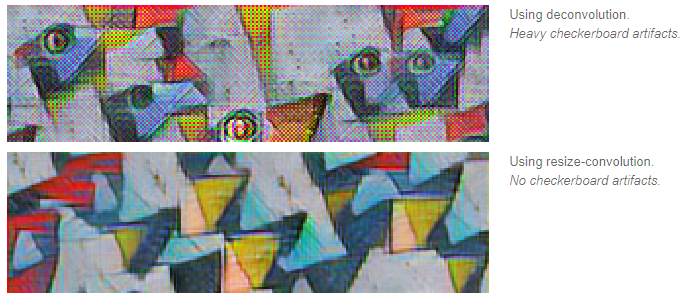

**Working of a Conv2D layer**

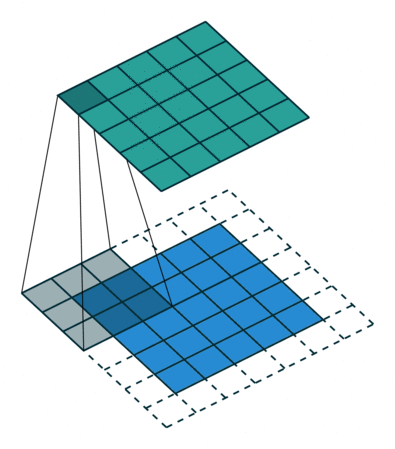

In [12]:
def upsampling_block(x, num_filters, kernel_size, strides=1, bn=False):
    
    x = UpSampling2D()(x)
    x = Conv2D(filters=num_filters, kernel_size=kernel_size, strides=strides, padding="same")(x)
    
    if bn:
      x = BatchNormalization()(x)
    x = Activation("relu")(x)
    return x

def build_generator(latent_dim):
    filters = [128, 64, 32]
  
    noise = Input(shape=(latent_dim,), name="generator_noise_input")

    x = Dense(7 * 7 * filters[0])(noise)
    x = Reshape((7, 7, filters[0]))(x)    #Shape 7x7x128
    for i in range(1, 3):
      x = upsampling_block(x, num_filters = filters[i], kernel_size = 5, strides = 1, bn = False)

    x = Conv2D(filters=IMG_SHAPE[2], kernel_size=5, padding='same', strides=1)(x) # Shape 28x28x1
    fake_output = Activation("tanh")(x)

    return Model(noise, fake_output, name="generator")


## Discriminator

In the context of GANs, a discriminator is responsible for evaluating the generated output of the generator. It essentially tries to distinguish the generated distribution from the target distribution.

The discriminator is a CNN-based image classifier, we use the tensorflow functions that help us define the discriminator.

In [15]:

def conv_block(x, num_filters, kernel_size, padding="same", strides=2, bn=False):
    
    x = Conv2D(filters=num_filters, kernel_size=kernel_size, padding=padding, strides=1)(x)
    x = Conv2D(filters=num_filters, kernel_size=kernel_size, padding=padding, strides=strides)(x)
    
    if bn:
        x = BatchNormalization()(x)
        
    x = Activation("relu")(x)
    x = Dropout(0.25)(x)
    return x

def build_discriminator():
    filters = [32, 64, 128]

    image_input = Input(shape=IMG_SHAPE) # Input image of shape 28x28x1
    x = image_input
    x = conv_block(x, num_filters = filters[0], kernel_size = 5, strides = 1, bn = False)
    for i in range(1, 3):
        x = conv_block(x, num_filters = filters[i], kernel_size = 5, strides = 2, bn = False)

    x = Flatten()(x)
    x = Dense(1)(x)
    x = Activation("sigmoid")(x)
    return Model(image_input, x, name="discriminator")


# Building and visualizing the generator and the discriminator models

 Construct the model on the TPU with **strategy.scope()**

In [16]:
with strategy.scope():
  d_model = build_discriminator()
  g_model = build_generator(noise_dim)
  g_model.summary()
  d_model.summary()

Model: "generator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
generator_noise_input (Input [(None, 128)]             0         
_________________________________________________________________
dense_1 (Dense)              (None, 6272)              809088    
_________________________________________________________________
reshape (Reshape)            (None, 7, 7, 128)         0         
_________________________________________________________________
up_sampling2d (UpSampling2D) (None, 14, 14, 128)       0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 14, 14, 64)        204864    
_________________________________________________________________
activation_4 (Activation)    (None, 14, 14, 64)        0         
_________________________________________________________________
up_sampling2d_1 (UpSampling2 (None, 28, 28, 64)        0 

**Loading a saved model (if available)**

In [17]:
#d_model = tf.keras.models.load_model('../input/gan-model-3/d_model.h5')
#g_model = tf.keras.models.load_model('../input/gan-model-3/g_model.h5')

# Defining the DCGAN model

The training loop begins with generator receiving a random seed as input. That seed is used to produce an image. The discriminator is then used to classify real images (drawn from the training set) and fakes images (produced by the generator). The loss is calculated for each of these models, and the gradients are used to update the generator and discriminator.

In [18]:
class DCGAN(keras.Model):
    def __init__(self,discriminator,generator,latent_dim):
        super(DCGAN, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim

    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):

        # Get the batch size
        batch_size = tf.shape(real_images)[0]
        # Create labels
        y_zeros = tf.zeros((batch_size,1), dtype=tf.int32)
        y_ones = tf.ones((batch_size,1), dtype=tf.int32)
        # Get the latent vector
        random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))

        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            # Generate fake images from the latent vector
            fake_images = self.generator(random_latent_vectors, training=True)
            # Get the probability for fake images
            fake_prob = self.discriminator(fake_images, training=True)
            # Get the probability for real images
            real_prob = self.discriminator(real_images, training=True)

            # Calculate discriminator loss using fake and real probability
            d_gen_loss = self.loss_fn(y_zeros,fake_prob)
            d_real_loss = self.loss_fn(y_ones,real_prob)
            d_loss = d_gen_loss + d_real_loss
            # Calculate generator loss using fake probability
            g_loss = self.loss_fn(y_ones,fake_prob)

        # Get the gradients w.r.t the discriminator loss
        d_gradient = disc_tape.gradient(d_loss, self.discriminator.trainable_variables)
        # Update the weights of the discriminator using the discriminator optimizer
        self.d_optimizer.apply_gradients(zip(d_gradient, self.discriminator.trainable_variables))
        
        # Get the gradients w.r.t the generator loss
        gen_gradient = gen_tape.gradient(g_loss, self.generator.trainable_variables)
        # Update the weights of the generator using the generator optimizer
        self.g_optimizer.apply_gradients(zip(gen_gradient, self.generator.trainable_variables))
        
        return {"d_loss": d_loss, "g_loss": g_loss}

# Initializing the GAN model

We initialize the loss functions as well as the optimizers that is used for training the GAN.

To begin training, construct the model on the TPU and then compile it.

In [19]:
def loss_fn(true, pred):
    loss = tf.keras.losses.BinaryCrossentropy(reduction=tf.keras.losses.Reduction.NONE)(true,pred)
    return loss

with strategy.scope():
  generator_optimizer = keras.optimizers.Adam(learning_rate=0.0001, beta_1=0.5, beta_2=0.9)
  discriminator_optimizer = keras.optimizers.Adam(learning_rate=0.0001, beta_1=0.5, beta_2=0.9)
  # Get the gan model
  dcgan = DCGAN(discriminator=d_model, generator=g_model, latent_dim=noise_dim)
  # Compile the gan model
  dcgan.compile(d_optimizer=discriminator_optimizer, g_optimizer=generator_optimizer, loss_fn=loss_fn)

# **Train the model**

Call the fit() method to train the generator and discriminator simultaneously according to the process defined in **train_step** function above. 

*Note, training GANs can be tricky. It's important that the generator and discriminator do not overpower each other (e.g., that they train at a similar rate).*

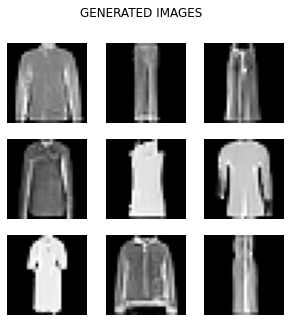

Epoch : 163
372/468 [======================>.......] - ETA: 2s - d_loss: 0.4069 - g_loss: 3.6488

In [ ]:
from IPython.display import clear_output
for j in range(200):  
  clear_output()
  noise = tf.random.normal(shape=(9, noise_dim))
  gen_im = g_model(noise)
  gen_im = gen_im.numpy()
  plt.figure(figsize=(5,5)).suptitle("GENERATED IMAGES")
  for i in range(9):
      plt.subplot(3,3, i+1)
      plt.axis("off")
      img=gen_im[i][:]
      img=(img+1)/2
      img = img.squeeze(axis=2)   # Convert from 28x28x1 -> 28x28
      plt.imshow(img, cmap='gray')
  plt.show()
  print("Epoch : {}".format(j))
  dcgan.fit(dataset, epochs=1)

# **Save the model**

In [ ]:
g_model.save("dcgan_g_model.h5")
d_model.save("dcgan_d_model.h5")

# **Plot and compare results**

In [ ]:
# PLOT IMAGES
noise = tf.random.normal(shape=(9, noise_dim))
gen_im = g_model(noise)
gen_im = gen_im.numpy()
plt.figure(figsize=(5,5)).suptitle("GENERATED IMAGES")
for i in range(9):
    plt.subplot(3,3, i+1)
    plt.axis("off")
    img=gen_im[i][:]
    img=(img+1)/2
    img = img.squeeze(axis=2)   # Convert from 28x28x1 -> 28x28
    plt.imshow(img, cmap='gray')

plt.figure(figsize=(5,5)).suptitle("REAL IMAGES")
for i in range(9):
    p = np.random.randint(1000)
    plt.subplot(3,3, i+1)
    plt.axis("off")
    img=real_imgs[p]
    plt.imshow(img, cmap='gray')


# Challenge

Use a different dataset, a dataset of your choice to make a GAN. A collection of dataset which can be easily used is found [here](https://console.cloud.google.com/storage/browser/quickdraw_dataset/full/numpy_bitmap?pageState=(%22StorageObjectListTable%22:(%22f%22:%22%255B%255D%22))&prefix=&forceOnObjectsSortingFiltering=false ). This is part of a Quick Draw dataset by google containing hand drawn doodles of 100s of common objects. 

You can download the npy file for the item you like and train a GAN on it.